## 1. Визуализация графика обучения

In [1]:
import os
import numpy as np

Загрузим лоссы на трейне и валидации за все время обучения

In [2]:
epoch_starts = []
stage_ends = []
cur_pos = 0
for i in range(4):
    # read validation loss on stage
    val_loss = np.loadtxt('part{}/val_losses.txt'.format(i + 1))
    if i == 0:
        val_losses = val_loss
    else:
        val_losses = np.concatenate([val_losses, val_loss])
        
    # read training loss for all epochs
    n_epochs = len(val_loss)
    for epoch in range(n_epochs):
        epoch_loss = np.loadtxt('part{}/losses_on_epoch{}.txt'.format(i + 1, epoch + 1))
        if i == 0 and epoch == 0:
            train_losses = epoch_loss
        else:
            train_losses = np.concatenate([train_losses, epoch_loss])
        cur_pos += len(epoch_loss)
        epoch_starts.append(cur_pos)
    stage_ends.append(cur_pos)

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
def running_mean(x, n):
    cumsum = np.cumsum(x)
    return (cumsum[n:] - cumsum[:-n]) / n

Text(0, 0.5, 'Huber loss')

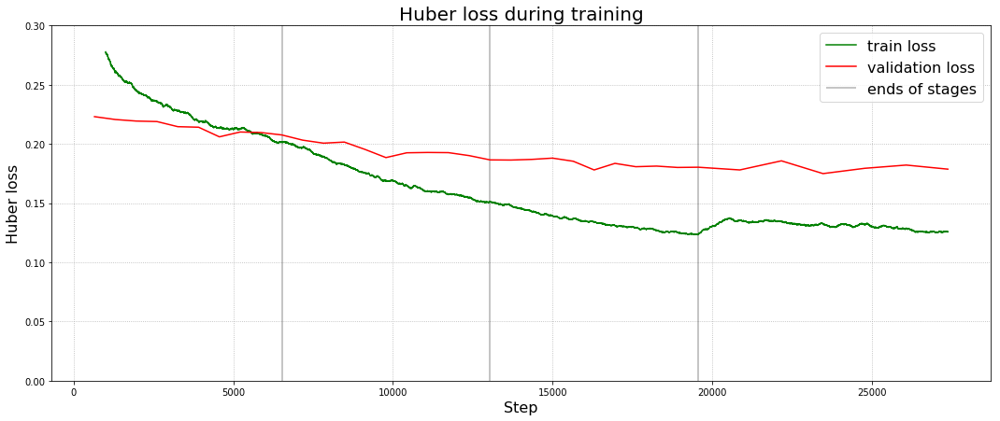

In [13]:
plt.figure(figsize=(18, 7))
plt.title('Huber loss during training', fontsize=20)
plt.grid(ls=':')
plt.plot(np.arange(1000, len(train_losses)), running_mean(train_losses, 1000), color='g', label='train loss')
plt.plot(epoch_starts, val_losses, color='r', label='validation loss')
plt.ylim((0, 0.3))
for i in range(3):
    if i == 0:
        plt.vlines(stage_ends[i], 0, 0.3, alpha=0.3, label='ends of stages')
    else:
        plt.vlines(stage_ends[i], 0, 0.3, alpha=0.3)
plt.legend(fontsize=16)
plt.xlabel('Step', fontsize=16)
plt.ylabel('Huber loss', fontsize=16)

## Визуализация работы нейросети

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [2]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_fullsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [6]:
def apply_upprojection(nn):
    n_filters = int(nn.shape[-1])
    batchnorm = BatchNormalization()(nn)
    upsampling = UpSampling2D()(batchnorm)
    conv = Conv2D(n_filters // 2, kernel_size=5, padding='same')(upsampling)
    relu = Activation('relu')(conv)
    conv_3 = Conv2D(n_filters // 2, kernel_size=3, padding='same')(relu)
    conv_proj = Conv2D(n_filters // 2, kernel_size=5, padding='same')(upsampling)
    add = Add()([conv_3, conv_proj])
    relu_2 = Activation('relu')(add)
    dropout = Dropout(0.5)(relu_2)
    return dropout


def apply_upconvolution(nn):
    n_filters = int(nn.shape[-1])
    batchnorm = BatchNormalization()(nn)
    upsampling = UpSampling2D()(batchnorm)
    conv = Conv2D(n_filters // 2, kernel_size=5, padding='same')(upsampling)
    relu = Activation('relu')(conv)
    dropout = Dropout(0.5)(relu)
    return dropout


def create_fcrn_model(encoder, deconv_type='projection', h=224, w=224):
    for layer in encoder.layers:
        layer.trainable = False
    encoder.compile(loss='mean_squared_error', optimizer='adam')
    resnet_output = encoder.output
    nn = Conv2D(1024, kernel_size=1, padding='same')(resnet_output)
    for k in range(5):
        if deconv_type == 'projection':
            nn = apply_upprojection(nn)
        if deconv_type ==  'convolution':
            nn = apply_upconvolution(nn)
    depth_output = Conv2D(1, kernel_size=3, padding='same')(nn)
    depth_output = Reshape((h, w))(depth_output)
    fcrn_model = Model(inputs=encoder.input, outputs=depth_output)
    return fcrn_model

In [7]:
from keras.applications.resnet50 import ResNet50
from keras.layers import *

In [8]:
model = ResNet50(input_shape=(384, 512, 3), include_top=False)

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


In [9]:
model = create_fcrn_model(model, h=384, w=512)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 384, 512, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 390, 518, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 192, 256, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 192, 256, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [11]:
from keras.models import load_model
model.load_weights('part4/model_on_epoch6.hdf5')

### Обучающая выборка

In [12]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [13]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [14]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.1827488316288018


In [15]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

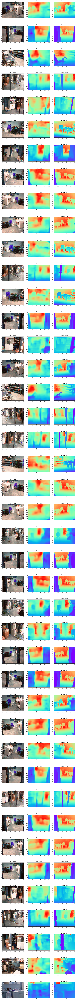

In [16]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [17]:
rgbs_val_sample = np.array(rgbs_val[::534])
depths_val_sample = np.array(depths_val[::534])

In [18]:
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

In [19]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))

validation MSE: 0.45883503585913676


In [20]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [26]:
%autosave 30

Autosaving every 30 seconds


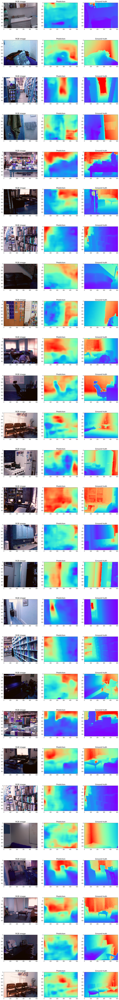

In [21]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: другие коллекции

In [27]:
rgbs_test_sample = np.array(rgbs_test[::100])
depths_test_sample = np.array(depths_test[::100])

In [28]:
test_prediction = model.predict(rgbs_test_sample, batch_size=32)

In [29]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

second-validation MSE: 0.8827539115286853


In [30]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

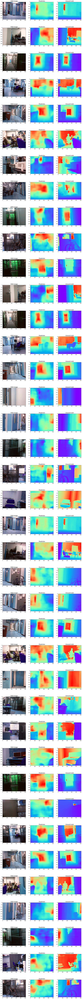

In [31]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')